#CO2.2 Final-Project RF-DETR for Object-Detection-


### Install dependencies

Install the RF-DETR SDK

To get started, we need to install the RF-DETR SDK. You can install the SDK with the following command:



In [ ]:
!pip install -q rfdetr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 266.3/266.3 kB 16.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 131.3/131.3 kB 12.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 843.1 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━

## Download Dataset from Roboflow

In [ ]:
# Install the Roboflow Python package
!pip install roboflow

# Import the Roboflow class
from roboflow import Roboflow

# Initialize Roboflow with your API key
rf = Roboflow(api_key="")  # ← Replace with your actual API key

# Access a specific project within the workspace
project = rf.workspace("prism-zhxxq").project("people-4wxxx")

# Access a specific version of the dataset
version = project.version(1)

# Download the dataset in COCO format (for object detection tasks)
dataset = version.download("coco")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to people-1 in coco:: 100%|██████████| 824/824 [00:00<00:00, 1977.92it/s]


In [ ]:
dataset.location

'/content/people-1'

## Train RF-DETR on custom dataset

In [ ]:
# Training hyperparameters
EPOCHS = 20                 # Maximum number of training epochs
BATCH_SIZE = 4              # Number of samples per batch
GRAD_ACCUM_STEPS = 4        # Number of steps to accumulate gradients before an optimizer step
LEARNING_RATE = 3e-4        # Learning rate for the optimizer

# Initialize the RF-DETR model
model = RFDETRBase()

# List to store training history for each epoch
history = []

# Early stopping to prevent overfitting; stops if validation loss doesn't improve for 3 epochs
early_stopper = EarlyStopping(patience=3)

# Callback function executed at the end of each epoch
def callback(data):
    history.append(data)                   # Save epoch data to history
    val_loss = data["test_loss"]           # Extract validation loss
    early_stopper.check(val_loss)          # Check for early stopping condition
    if early_stopper.early_stop:
        print(f"Early stopping triggered at epoch {data['epoch']} (val loss: {val_loss:.4f})")
        raise StopIteration                # Stop training early by raising an exception

# Register the callback to run at the end of each epoch
model.callbacks["on_fit_epoch_end"].append(callback)

# Begin model training, with early stopping handled via exception
try:
    model.train(
        dataset_dir=dataset.location,
        epochs=EPOCHS,
        batch_size=BATCH_SIZE,
        grad_accum_steps=GRAD_ACCUM_STEPS,
        lr=LEARNING_RATE
    )
except StopIteration:
    pass


rf-detr-base.pth: 100%|██████████| 355M/355M [00:17<00:00, 21.6MiB/s]


Loading pretrain weights


reinitializing your detection head with 2 classes.


TensorBoard logging initialized. To monitor logs, use 'tensorboard --logdir output' and open http://localhost:6006/ in browser.
Not using distributed mode
git:
  sha: N/A, status: clean, branch: N/A

Namespace(num_classes=2, grad_accum_steps=4, amp=True, lr=0.0001, lr_encoder=0.00015, batch_size=4, weight_decay=0.0001, epochs=20, lr_drop=100, clip_max_norm=0.1, lr_vit_layer_decay=0.8, lr_component_decay=0.7, do_benchmark=False, dropout=0, drop_path=0.0, drop_mode='standard', drop_schedule='constant', cutoff_epoch=0, pretrained_encoder=None, pretrain_weights='rf-detr-base.pth', pretrain_exclude_keys=None, pretrain_keys_modify_to_load=None, pretrained_distiller=None, encoder='dinov2_windowed_small', vit_encoder_num_layers=12, window_block_indexes=None, position_embedding='sine', out_feature_indexes=[2, 5, 8, 11], freeze_encoder=False, layer_norm=True, rms_norm=False, backbone_lora=False, force_no_pretrain=False, dec_layers=3, dim_feedforward=2048, hidden_dim=256, sa_nheads=8, ca_nheads=1

Epoch: [0]  [ 0/35]  eta: 0:05:39  lr: 0.000100  class_error: 4.52  loss: 11.1669 (11.1669)  loss_ce: 1.0289 (1.0289)  loss_bbox: 0.7711 (0.7711)  loss_giou: 0.7740 (0.7740)  loss_ce_0: 0.8980 (0.8980)  loss_bbox_0: 1.0390 (1.0390)  loss_giou_0: 0.9622 (0.9622)  loss_ce_1: 0.9755 (0.9755)  loss_bbox_1: 0.8390 (0.8390)  loss_giou_1: 0.8356 (0.8356)  loss_ce_enc: 0.8383 (0.8383)  loss_bbox_enc: 1.1357 (1.1357)  loss_giou_enc: 1.0698 (1.0698)  loss_ce_unscaled: 1.0289 (1.0289)  class_error_unscaled: 4.5249 (4.5249)  loss_bbox_unscaled: 0.1542 (0.1542)  loss_giou_unscaled: 0.3870 (0.3870)  cardinality_error_unscaled: 175.2500 (175.2500)  loss_ce_0_unscaled: 0.8980 (0.8980)  loss_bbox_0_unscaled: 0.2078 (0.2078)  loss_giou_0_unscaled: 0.4811 (0.4811)  cardinality_error_0_unscaled: 895.0000 (895.0000)  loss_ce_1_unscaled: 0.9755 (0.9755)  loss_bbox_1_unscaled: 0.1678 (0.1678)  loss_giou_1_unscaled: 0.4178 (0.4178)  cardinality_error_1_unscaled: 1236.7500 (1236.7500)  loss_ce_enc_unscaled: 0.

In [ ]:
model

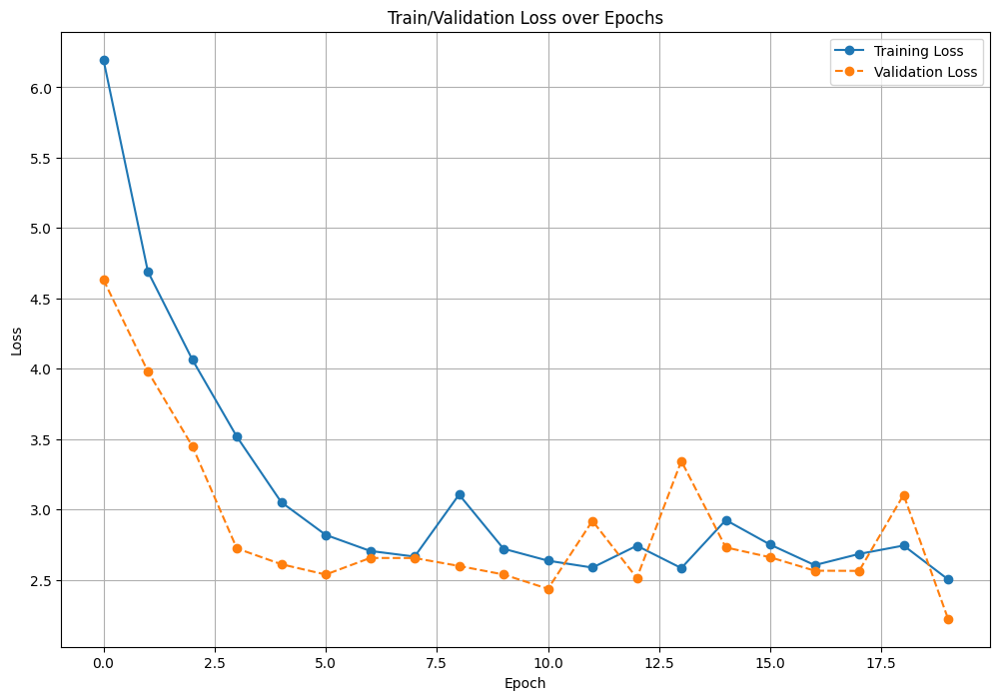

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

df = pd.DataFrame(history)

plt.figure(figsize=(12, 8))

plt.plot(
    df['epoch'],
    df['train_loss'],
    label='Training Loss',
    marker='o',
    linestyle='-'
)

plt.plot(
    df['epoch'],
    df['test_loss'],
    label='Validation Loss',
    marker='o',
    linestyle='--'
)

plt.title('Train/Validation Loss over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.show()

### Average Precision

The graph below represents the Average Precision (AP) over training epochs across different Intersection Over Union (IOU) thresholds  (0.50 to 0.95, in steps of 0.05).



**Average Precision (AP)**

Average Precision (AP) is a key metric used to evaluate object detection models. It measures how well a model detects objects across different confidence thresholds by considering both precision and recall.

**Understanding Precision & Recall**

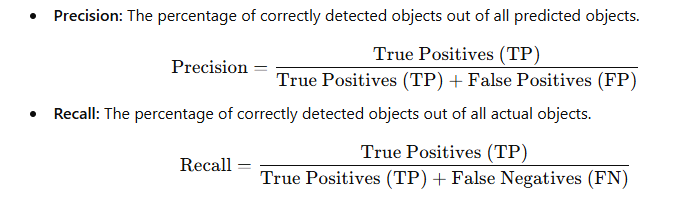

**How AP is Calculated**

**Precision-Recall (PR) Curve:**

The model predicts objects at different confidence scores (thresholds).

A Precision-Recall Curve is plotted by varying the threshold and computing precision vs. recall.

**Compute AP:**

The AP is the area under the Precision-Recall (PR) curve.

Higher AP means better object detection performance.

**AP (IoU=0.50:0.95) Meaning**

IoU (Intersection over Union) measures how much the predicted bounding box overlaps with the ground truth.

AP at IoU 0.50:0.95 is the mean AP calculated at multiple IoU thresholds (0.50 to 0.95, in steps of 0.05).



**Key Takeaways**

Good Model Performance: The AP value around 0.60 is relatively high, indicating decent object detection capability.

Training Convergence: The model stops improving significantly after ~10 epochs, meaning further training may not bring substantial gains.

*italicized text*### Average Recall

The graph below represents the Average Recall (AR) over training epochs across different Intersection Over Union (IOU) thresholds.



The AR starts at a lower value and increases rapidly in the first few epochs.

It then stabilizes around 0.32 - 0.34, with minor fluctuations.

The trend suggests the model is learning effectively but may still be improving gradually

**Average Recall (AR)** is a metric used in object detection to evaluate the model's ability to detect objects across different Intersection Over Union (IOU) thresholds. It is a mean recall over a range of IOU values, typically from 0.50 to 0.95 with steps of 0.05

**How AR is Calculated**

The recall is measured at multiple IoU thresholds (e.g., 0.50, 0.55, 0.60, ..., 0.95).

The average of these recall values gives the Average Recall (AR).



**Key Concepts**

Recall measures how many true positives the model correctly detects out of the total available ground-truth objects.

IoU (Intersection over Union) is the ratio of the overlapping area between the predicted bounding box and the ground truth box to the union of both areas.

Higher AR indicates that the model detects more objects correctly across various IoU thresholds.

### Results

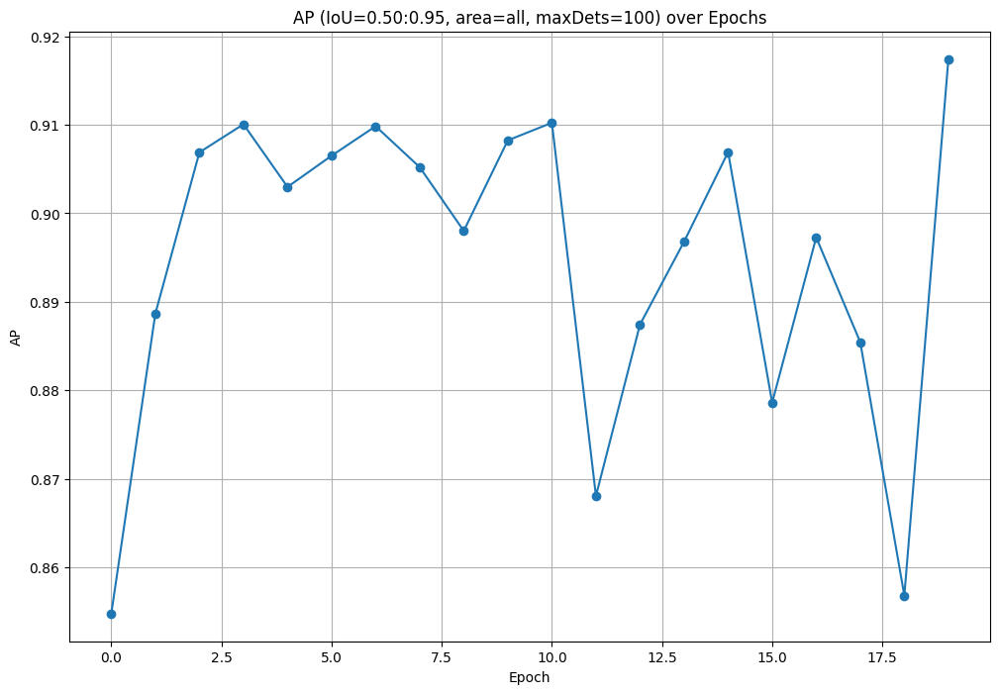

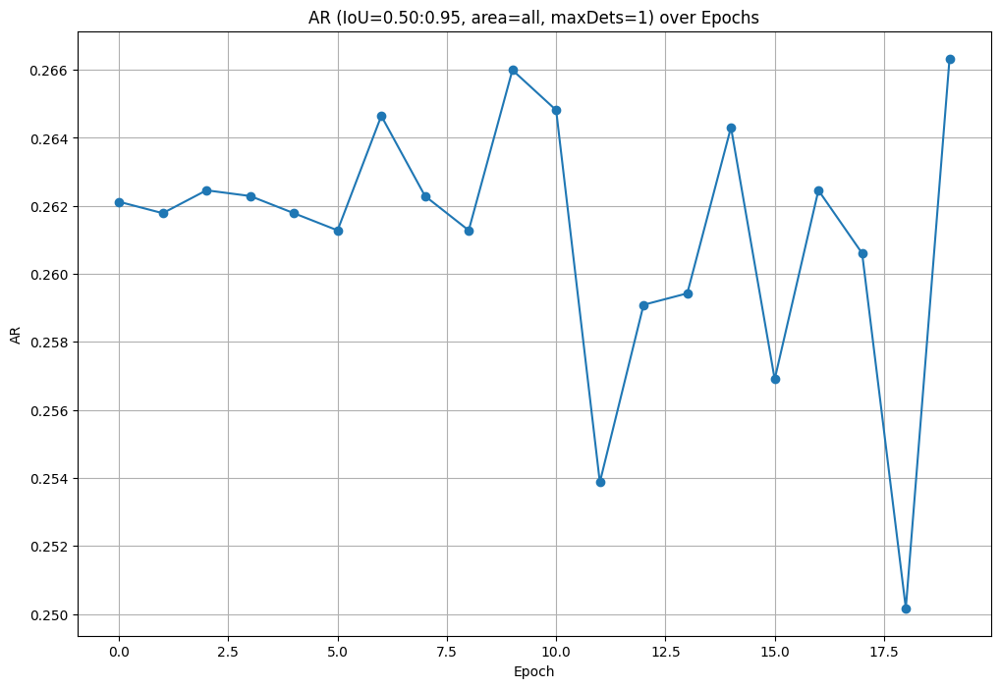

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

df = pd.DataFrame(history)

df['avg_precision'] = df['test_coco_eval_bbox'].apply(lambda arr: arr[0])
df['avg_recall'] = df['test_coco_eval_bbox'].apply(lambda arr: arr[6])

plt.figure(figsize=(12, 8))
plt.plot(
    df['epoch'],
    df['avg_precision'],
    marker='o',
    linestyle='-'
)
plt.title('AP (IoU=0.50:0.95, area=all, maxDets=100) over Epochs')
plt.xlabel('Epoch')
plt.ylabel('AP')
plt.grid(True)
plt.show()


plt.figure(figsize=(12, 8))
plt.plot(
    df['epoch'],
    df['avg_recall'],
    marker='o',
    linestyle='-'
)
plt.title('AR (IoU=0.50:0.95, area=all, maxDets=1) over Epochs')
plt.xlabel('Epoch')
plt.ylabel('AR')
plt.grid(True)
plt.show()

## Run inference with fine-tuned model

In [ ]:
import supervision as sv
# Load a detection dataset in COCO format using Supervision's DetectionDataset class

ds = sv.DetectionDataset.from_coco(
    images_directory_path=f"{dataset.location}/test",
    annotations_path=f"{dataset.location}/test/_annotations.coco.json",
)

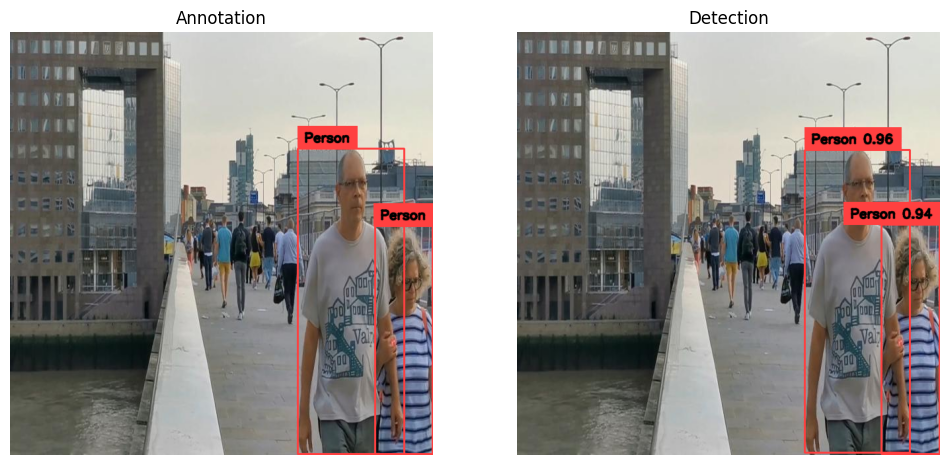

In [ ]:
from rfdetr import RFDETRBase        # Import the base RF-DETR model
import supervision as sv             # For visualizing and annotating images
from PIL import Image                # For image loading

# Load the first item from the dataset: path, image object, and ground-truth annotations
path, image, annotations = ds[0]
image = Image.open(path)             # Open the image using PIL

# Run inference with RF-DETR on the image (confidence threshold: 0.5)
detections = model.predict(image, threshold=0.5)

# Automatically calculate label text size and line thickness based on image resolution
text_scale = sv.calculate_optimal_text_scale(resolution_wh=image.size)
thickness = sv.calculate_optimal_line_thickness(resolution_wh=image.size)

# Initialize annotators for bounding boxes and labels
bbox_annotator = sv.BoxAnnotator(thickness=thickness)
label_annotator = sv.LabelAnnotator(
    text_color=sv.Color.BLACK,
    text_scale=text_scale,
    text_thickness=thickness,
    smart_position=True
)

# Prepare labels for ground truth annotations (e.g., "person", "car")
annotations_labels = [
    f"{ds.classes[class_id]}"
    for class_id in annotations.class_id
]

# Prepare labels for model detections with confidence (e.g., "person 0.95")
detections_labels = [
    f"{ds.classes[class_id]} {confidence:.2f}"
    for class_id, confidence in zip(detections.class_id, detections.confidence)
]

# Copy image and annotate with ground-truth boxes and labels
annotation_image = image.copy()
annotation_image = bbox_annotator.annotate(annotation_image, annotations)
annotation_image = label_annotator.annotate(annotation_image, annotations, annotations_labels)

# Copy image and annotate with predicted boxes and labels
detections_image = image.copy()
detections_image = bbox_annotator.annotate(detections_image, detections)
detections_image = label_annotator.annotate(detections_image, detections, detections_labels)

# Display both images side-by-side for comparison: ground-truth vs prediction
sv.plot_images_grid(
    images=[annotation_image, detections_image],
    grid_size=(1, 2),
    titles=["Annotation", "Detection"]
)


In [ ]:
print(f"Dataset contains {len(ds)} items")


Dataset contains 82 items


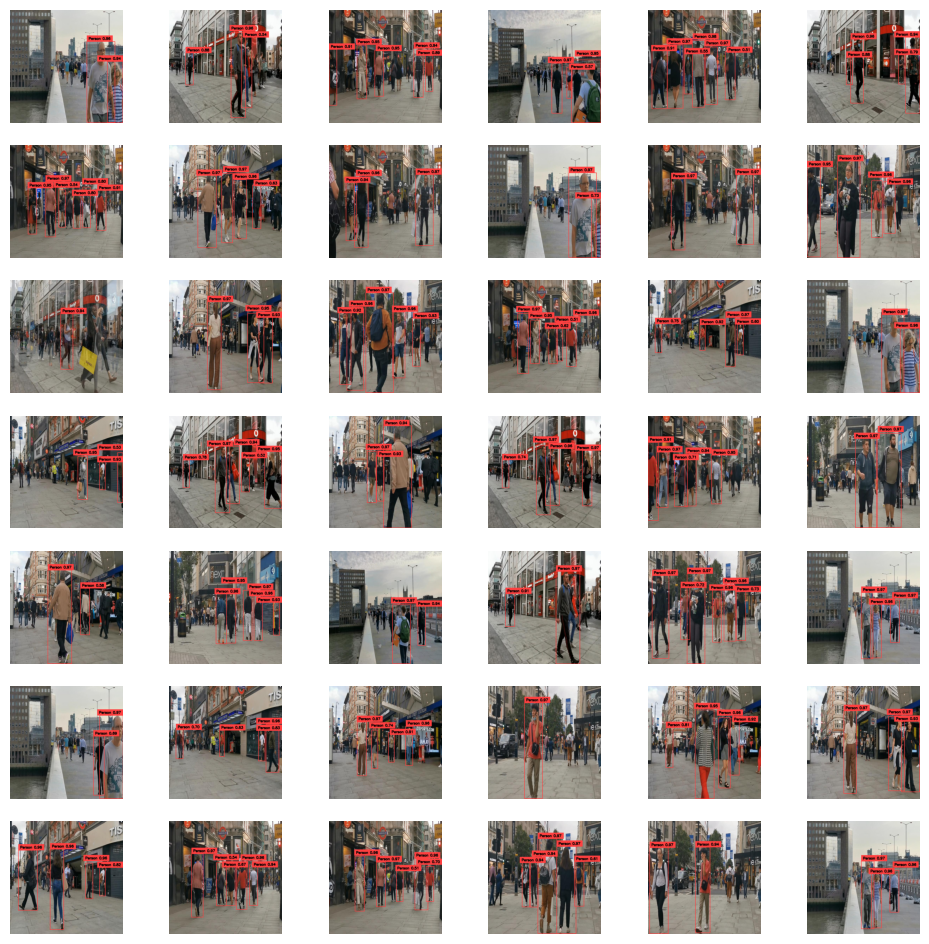

In [ ]:
num_items = 42  # Number of images to process from the dataset

detections_images = []  # List to store annotated detection images

# Loop over the first `num_items` samples in the dataset
for i in range(num_items):
    # Load image and its metadata from dataset
    path, image, annotations = ds[i]
    image = Image.open(path)

    # Run object detection on the image
    detections = model.predict(image, threshold=0.5)

    # Dynamically calculate label text size and box thickness based on image resolution
    text_scale = sv.calculate_optimal_text_scale(resolution_wh=image.size)
    thickness = sv.calculate_optimal_line_thickness(resolution_wh=image.size)

    # Create annotators for drawing bounding boxes and labels
    bbox_annotator = sv.BoxAnnotator(thickness=thickness)
    label_annotator = sv.LabelAnnotator(
        text_color=sv.Color.BLACK,
        text_scale=text_scale,
        text_thickness=thickness,
        smart_position=True
    )

    # Format predicted labels with class names and confidence scores
    detections_labels = [
        f"{ds.classes[class_id]} {confidence:.2f}"
        for class_id, confidence in zip(detections.class_id, detections.confidence)
    ]

    # Annotate the image with predicted bounding boxes and labels
    detections_image = image.copy()
    detections_image = bbox_annotator.annotate(detections_image, detections)
    detections_image = label_annotator.annotate(detections_image, detections, detections_labels)

    # Save the annotated image to the list
    detections_images.append(detections_image)

# Compute grid size to display all annotated images
import math
grid_rows = math.ceil(math.sqrt(num_items))
grid_cols = math.ceil(num_items / grid_rows)

# Plot all detection results in a grid
sv.plot_images_grid(
    images=detections_images,
    grid_size=(grid_rows, grid_cols)
)


## Evaluate fine-tuned model

In [ ]:
import supervision as sv
from tqdm import tqdm
from supervision.metrics import MeanAveragePrecision

targets = []
predictions = []

for path, image, annotations in tqdm(ds):
    image = Image.open(path)
    detections = model.predict(image, threshold=0.5)

    targets.append(annotations)
    predictions.append(detections)

100%|██████████| 82/82 [00:05<00:00, 15.71it/s]


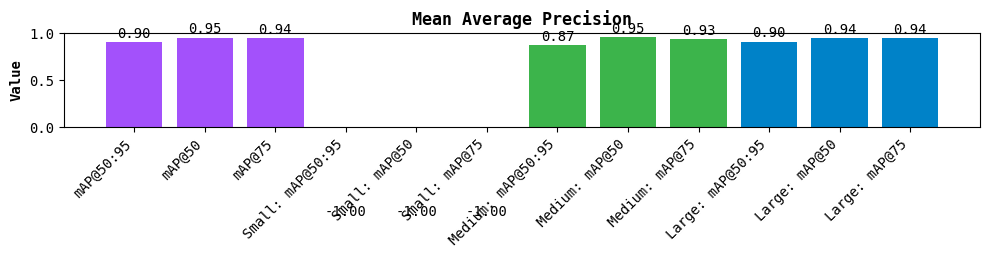

In [ ]:
map_metric = MeanAveragePrecision()
map_result = map_metric.update(predictions, targets).compute()

map_result.plot()

### Confusion Matrix

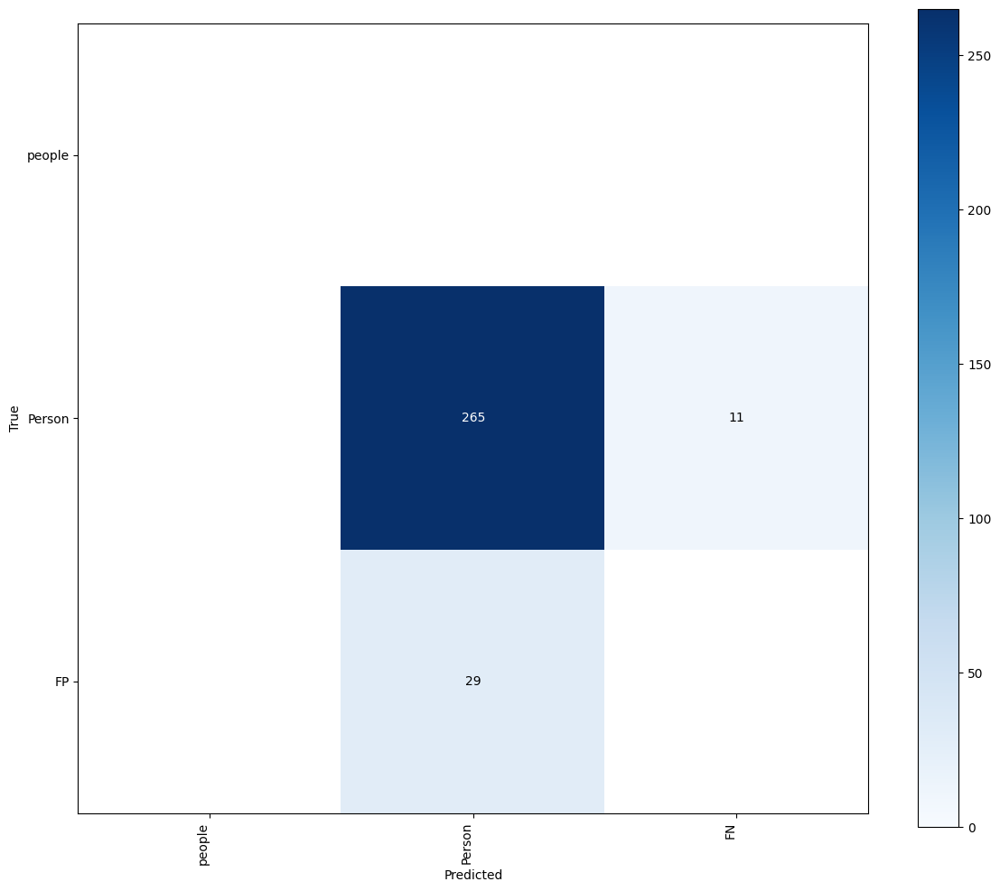

In [ ]:
confusion_matrix = sv.ConfusionMatrix.from_detections(
    predictions=predictions,
    targets=targets,
    classes=ds.classes
)

_ = confusion_matrix.plot()
plt.show()


### Inference with Custom Model on Videos

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!gdown "https://drive.google.com/uc?id=1iMitK9VCUWmBcZiiEPHK1d2pydALof6s&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1iMitK9VCUWmBcZiiEPHK1d2pydALof6s&confirm=t
To: /content/demo.mp4
100% 4.39M/4.39M [00:00<00:00, 22.3MB/s]


In [ ]:
classes = {1:"person"}

In [ ]:
# Set input and output video file paths
SOURCE_VIDEO_PATH = "/content/drive/MyDrive/demo.mp4"
TARGET_VIDEO_PATH = "/content/drive/MyDrive/output_video.mp4"

# Create a frame generator to read frames from the source video
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

# Extract video metadata (e.g., frame rate, resolution)
video_info = sv.VideoInfo.from_video_path(SOURCE_VIDEO_PATH)

# Open a VideoSink to write annotated frames to the output video
with sv.VideoSink(TARGET_VIDEO_PATH, video_info) as sink:
    for frame in tqdm(frame_generator, desc="Processing video"):

        # Run object detection on each frame
        detections = model.predict(frame, threshold=0.5, iou=0.1)

        # Map detected class IDs to their class names
        labels = []
        for class_id in detections.class_id:
            class_name = classes.get(class_id)  # Lookup from class dictionary
            labels.append(class_name)

        # Make a copy of the frame for annotation
        annotated_frame = frame.copy()

        # Draw bounding boxes on the frame
        annotated_frame = sv.BoxAnnotator().annotate(
            scene=annotated_frame, detections=detections
        )

        # Draw labels (class names) on the frame
        annotated_frame = sv.LabelAnnotator(text_thickness=2).annotate(
            scene=annotated_frame,
            detections=detections,
            labels=labels
        )

        # Write the annotated frame to the output video
        sink.write_frame(annotated_frame)

# Confirm completion
print(f"Video processing complete. Output saved to {TARGET_VIDEO_PATH}")


Processing video: 1932it [01:53, 16.99it/s]

Video processing complete. Output saved to /content/drive/MyDrive/output_video.mp4


### Display the Output Video

In [ ]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Original video path (e.g., generated and saved during inference or visualization)
save_path = "/content/drive/MyDrive/output_video.mp4"

# Path to save the compressed version of the video
compressed_path = "/content/result_compressed.mp4"

# Compress the video using ffmpeg with H.264 codec
os.system(f"ffmpeg -y -i '{save_path}' -vcodec libx264 '{compressed_path}'")

# Verify that compression succeeded
if not os.path.exists(compressed_path):
    raise FileNotFoundError(f"Compression failed. File not found at: {compressed_path}")

# Read the compressed video in binary and encode it as base64
with open(compressed_path, 'rb') as f:
    mp4 = f.read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

# Display the video inline (in Jupyter, Colab, etc.)
HTML(f"""
<video width=400 controls>
      <source src="{data_url}" type="video/mp4">
</video>
""")



### Load and run fine-tuned model


Loading pretrain weights


reinitializing detection head with 1 classes


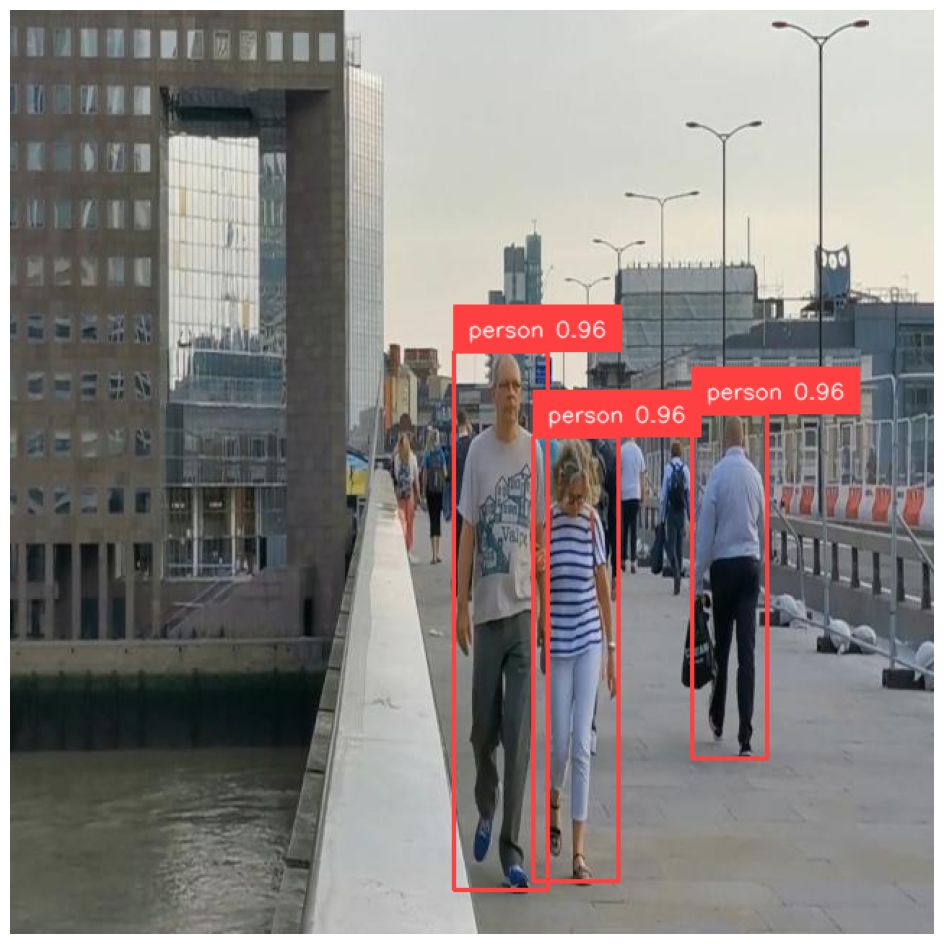

In [ ]:
import io
import requests
import supervision as sv
from PIL import Image
from rfdetr import RFDETRBase
from rfdetr.util.coco_classes import COCO_CLASSES  # List of COCO class names

# Load your fine-tuned RF-DETR model with custom checkpoint
model = RFDETRBase(pretrain_weights="/content/output/checkpoint.pth")

# Load a test image from local path
image = Image.open("/content/people-1/test/yt-YzcawvDGe4Y-0745_jpg.rf.714717e94a4de23371aa293e502f3ace.jpg")

# Run object detection on the image
detections = model.predict(image, threshold=0.5)

# Prepare labels with class names and confidence scores (e.g., "person 0.89")
labels = [
    f"{COCO_CLASSES[class_id]} {confidence:.2f}"
    for class_id, confidence in zip(detections.class_id, detections.confidence)
]

# Annotate the image with bounding boxes and labels
annotated_image = image.copy()
annotated_image = sv.BoxAnnotator().annotate(annotated_image, detections)
annotated_image = sv.LabelAnnotator().annotate(annotated_image, detections, labels)

# Display the annotated image
sv.plot_image(annotated_image)


In [ ]:
import json

# Load evaluation results from a JSON file
with open("/content/output/results.json", "r") as f:
    results = json.load(f)

# Extract test metrics (assuming test results are in index 0 under 'class_map' → 'test')
test_metrics = results["class_map"]["test"][0]

# Print key evaluation metrics
print("Evaluation Metrics on Test Set:")
print(f"mAP@50:95: {test_metrics['map@50:95']:.4f}")   # Mean Average Precision across IoU thresholds 0.50 to 0.95
print(f"mAP@50: {test_metrics['map@50']:.4f}")         # Mean Average Precision at IoU=0.50
print(f"Precision: {test_metrics['precision']:.4f}")   # Preci_


Evaluation Metrics on Test Set:
mAP@50:95: 0.9195
mAP@50: 0.9701
Precision: 0.9123
Recall: 0.9400


# References

https://www.analyticsvidhya.com/blog/2025/03/roboflows-rf-detr/

https://doi.org/10.3390/s24113610

https://blog.roboflow.com/rf-detr/

https://doi.org/10.48550/arXiv.2504.13099

https://learnopencv.com/rf-detr-object-detection/